# State Counts Map Plot

In [54]:
import pandas as pd
import numpy as np
import sketch

import matplotlib.pyplot as plt 
import plotly.express as px
import plotly.graph_objs as go

from urllib.request import urlopen
import json
import re

In [2]:
clients_path = 'train_data_npo/npo_clnts.csv'
clean_clients_path = 'clean_data/clients_df.csv'
contributors_path = 'train_data_npo/npo_cntrbtrs.csv'
transactions_path = 'train_data_npo/npo_trnsctns.csv'

clients_features = {
    "clnt_id" : "ID клиента",
    "slctn_nmbr" : "Номер выборки",
    "gndr" : "Пол клиента: м: 0, ж: 1",
    "age" : "Возраст клиента, лет",
    "brth_yr" : "Год рождения клиента",
    "pstl_code" : "Почтовый индекс",
    "city" : "Живет клиент в городе (1) или нет (0)"
}

contributors_features = {
    "npo_accnt_id" : "ID счета клиента",
    "client_id" : "ID клиента",
    "slctn_nmbr" : "Номер выборки",
    "accnt_pnsn_schm" : "Условный код пенсионной схемы счета клиента",
    "npo_accnt_status" : "Статус счета клиента: Закрыт: 0, Открыт: 1",
    "npo_accnt_status_date" : "Дата статуса счета клиента",
    "npo_blnc" : "Баланс счета клиента, руб.",
    "npo_pmnts_sum" : "Сумма взносов клиента, руб.",
    "npo_pmnts_nmbr" : "Число взносов клиента",
    "npo_frst_pmnt_date" : "Дата первого взноса клиента",
    "npo_lst_pmnt_date" : "Дата последнего взноса клиента",
    "npo_ttl_incm" : "Сумма дохода, начисленного на счет клиента, руб."
}

transactions_features = {
    "npo_accnt_id" : "ID клиента",
    "slctn_nmbr" : "Номер выборки",
    "npo_sum" : "Размер операции по счету клиента, руб.",
    "npo_operation_date" : "Дата взноса клиента",
    "npo_operation_group" : "Тип операции по счету клиента: Поступление взносов: 0, Начисление дохода: 1",
}

In [3]:
clients_df = pd.read_csv(clean_clients_path)
contributors_df = pd.read_csv(contributors_path)
transactions_df = pd.read_csv(transactions_path)
clients_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209976 entries, 0 to 209975
Data columns (total 8 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   clnt_id     209976 non-null  object 
 1   gndr        209976 non-null  float64
 2   slctn_nmbr  209976 non-null  int64  
 3   age         209976 non-null  float64
 4   brth_yr     209976 non-null  float64
 5   pstl_code   209976 non-null  object 
 6   city        209976 non-null  int64  
 7   state_name  209976 non-null  object 
dtypes: float64(3), int64(2), object(3)
memory usage: 12.8+ MB


In [4]:
# Group by the values of the column slctn_nmbr
grouped_df = clients_df.groupby('slctn_nmbr')
grouped_df.head(1)

,clnt_id,gndr,slctn_nmbr,age,brth_yr,pstl_code,city,state_name
0,0xD1930AC934CD0D4AB6141DF45637EFE4,1.0,2,74.0,1949.0,188544,0,Ленинградская Область
2,0xCF29021EFE24454693866565B7CAB0D8,1.0,0,69.0,1954.0,162609.0,0,Вологодская Область
5,0x4BD4855E4D56D343B8C86694373DE94C,0.0,1,45.0,1977.0,193079.0,1,Санкт-Петербург
7,0xA7F12C768A4FB38311E835B493872962,1.0,3,63.0,1960.0,624980,0,Свердловская Область


In [5]:
grouped_df.describe()['age']

,count,mean,std,min,25%,50%,75%,max
slctn_nmbr,,,,,,,,
0,42408.0,54.595855,12.313632,10.0,44.0,55.0,64.0,107.0
1,38465.0,56.430235,15.966065,7.0,43.0,55.0,68.0,110.0
2,121021.0,55.032738,11.223228,7.0,47.0,57.0,63.0,103.0
3,8082.0,51.125093,11.400075,1.0,43.0,50.0,59.0,106.0


In [6]:
clients_df.sketch.howto("Using plotly, plot a map of total users in each state in Russia")

In [7]:
# Get the total number of users in each state
state_counts = clients_df.groupby('state_name')['clnt_id'].count().reset_index()
for name in state_counts['state_name']:
    print(name)

Адыгея Республика
Алтай Республика
Алтайский Край
Амурская Область
Архангельская Область
Астраханская Область
Башкортостан Республика
Белгородская Область
Брянская Область
Бурятия Республика
Владимирская Область
Волгоградская Область
Вологодская Область
Воронежская Область
Дагестан Республика
Ивановская Область
Ингушетия Республика
Иркутская Область
Кабардино-Балкарская Республика
Калининградская Область
Калмыкия Республика
Калужская Область
Камчатская Область
Карачаево-Черкесская Республика
Карелия Республика
Кемеровская Область
Кировская Область
Коми Республика
Костромская Область
Краснодарский Край
Красноярский Край
Курганская Область
Курская Область
Ленинградская Область
Липецкая Область
Магаданская Область
Марий Эл Республика
Мордовия Республика
Москва
Московская Область
Мурманская Область
Нижегородская Область
Новгородская Область
Новосибирская Область
Омская Область
Оренбургская Область
Орловская Область
Пензенская Область
Пермский Край
Приморский Край
Псковская Область
Ростовск

In [20]:
"""with urlopen('https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/russia.geojson') as response:
    counties = json.load(response)"""

russia_geojson_path = 'russia.geojson'
with open(russia_geojson_path, 'r') as j:
     counties = json.loads(j.read())

counties['crs']={'type': 'name', 'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}}

In [9]:
state_counts['state_name'] = state_counts['state_name'].str.lower()
state_names_not_in_df = []
for k in range(len(counties['features'])):
    counties['features'][k]['properties']['name'] = counties['features'][k]['properties']['name'].lower()
    name = counties['features'][k]['properties']['name']
    if name not in state_counts['state_name'].values:
        state_names_not_in_df.append(name)

print(state_names_not_in_df)

['бурятия', 'ненецкий автономный округ', 'камчатский край', 'тыва', 'ханты-мансийский автономный округ - югра', 'чукотский автономный округ', 'адыгея', 'республика калмыкия', 'республика мордовия', 'татарстан', 'марий эл', 'чувашия', 'северная осетия - алания', 'забайкальский край', 'алтай', 'ямало-ненецкий автономный округ', 'республика саха (якутия)', 'дагестан', 'республика коми', 'республика карелия', 'еврейская автономная область', 'республика хакасия', 'ингушетия', 'башкортостан']


In [10]:
# Iterate through rows of clients_df
for index, name in enumerate(state_counts['state_name']):
    if name[-10:] == 'республика':
        proper_name = name[:-11]
        if proper_name in state_names_not_in_df:
            state_counts.loc[index, 'state_name'] = proper_name
            index_of_proper_name = state_names_not_in_df.index(proper_name)
            state_names_not_in_df.pop(index_of_proper_name)
        
print(state_names_not_in_df)

['ненецкий автономный округ', 'камчатский край', 'ханты-мансийский автономный округ - югра', 'чукотский автономный округ', 'республика калмыкия', 'республика мордовия', 'чувашия', 'северная осетия - алания', 'забайкальский край', 'ямало-ненецкий автономный округ', 'республика саха (якутия)', 'республика коми', 'республика карелия', 'еврейская автономная область', 'республика хакасия']


In [11]:
state_counts['state_name'] = state_counts['state_name'].replace('камчатская область', 'камчатский край')
state_names_not_in_df.pop(state_names_not_in_df.index('камчатский край'))

state_counts['state_name'] = state_counts['state_name'].replace('калмыкия республика', 'республика калмыкия')
state_names_not_in_df.pop(state_names_not_in_df.index('республика калмыкия'))

state_counts['state_name'] = state_counts['state_name'].replace('мордовия республика', 'республика мордовия')
state_names_not_in_df.pop(state_names_not_in_df.index('республика мордовия'))

state_counts['state_name'] = state_counts['state_name'].replace('северная осетия-алания республика', 'северная осетия - алания')
state_names_not_in_df.pop(state_names_not_in_df.index('северная осетия - алания'))

state_counts['state_name'] = state_counts['state_name'].replace('саха (якутия) республика', 'республика саха (якутия)')
state_names_not_in_df.pop(state_names_not_in_df.index('республика саха (якутия)'))

state_counts['state_name'] = state_counts['state_name'].replace('коми республика', 'республика коми')
state_names_not_in_df.pop(state_names_not_in_df.index('республика коми'))

state_counts['state_name'] = state_counts['state_name'].replace('карелия республика', 'республика карелия')
state_names_not_in_df.pop(state_names_not_in_df.index('республика карелия'))

state_counts['state_name'] = state_counts['state_name'].replace('хакасия республика', 'республика хакасия')
state_names_not_in_df.pop(state_names_not_in_df.index('республика хакасия'))

state_counts['state_name'] = state_counts['state_name'].replace('чувашская республика', 'чувашия')
state_names_not_in_df.pop(state_names_not_in_df.index('чувашия'))

print(state_names_not_in_df)


['ненецкий автономный округ', 'ханты-мансийский автономный округ - югра', 'чукотский автономный округ', 'забайкальский край', 'ямало-ненецкий автономный округ', 'еврейская автономная область']


In [12]:
state_counts['state_id'] = None
for k in range(len(counties['features'])):
    counties['features'][k]['properties']['cartodb_id'] = k
    state_counts.loc[state_counts['state_name'] == counties['features'][k]['properties']['name'], 'state_id'] = k

In [13]:
state_counts.state_name = state_counts.state_name.str.title()
state_counts = state_counts.dropna()
state_counts

,state_name,clnt_id,state_id
0,Адыгея,114,25
1,Алтай,24,57
2,Алтайский Край,851,11
3,Амурская Область,462,72
4,Архангельская Область,1168,52
...,...,...,...
72,Республика Хакасия,119,76
73,Челябинская Область,3889,81
74,Чеченская Республика,677,65
76,Чувашия,380,45


In [14]:
state_counts.to_csv('clean_data/state_counts.csv')

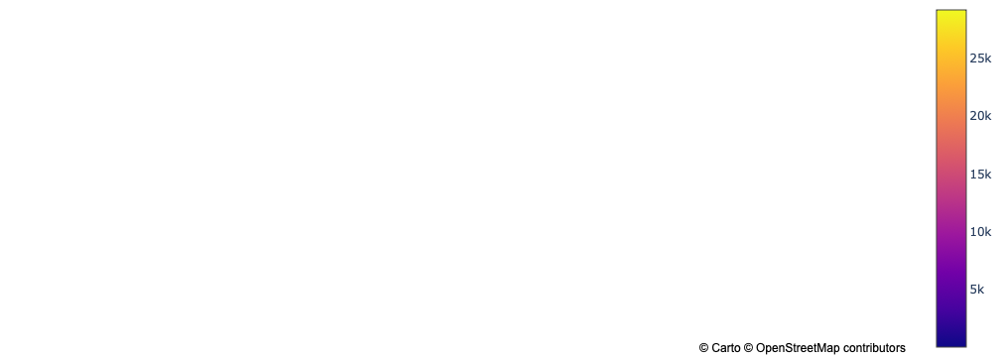

In [79]:
# Create a map of Russia with the total number of users in each state
fig = go.Figure(go.Choroplethmapbox(geojson=counties,
                    locations=state_counts['state_id'], 
                    z=state_counts['clnt_id'])
               )
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=1.5, mapbox_center = {"lat": 66, "lon": 94})
fig.update_traces(marker_line_width=0)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [22]:
import geopandas as gpd

In [39]:
gdf = gpd.GeoDataFrame.from_features(counties["features"])

In [41]:
gdf

,geometry,name,cartodb_id,created_at,updated_at,name_latin
0,"POLYGON ((99.23057 52.96319, 99.24053 52.98642...",Бурятия,10,2013-12-04T04:23:51+0100,2013-12-04T08:04:02+0100,Republic of Buryatia
1,"POLYGON ((41.73682 44.47313, 41.79265 44.47052...",Карачаево-Черкесская республика,13,2013-12-04T04:23:51+0100,2013-12-04T08:04:37+0100,Karachay-Cherkess Republic
2,"MULTIPOLYGON (((145.98748 43.36928, 146.01625 ...",Сахалинская область,11,2013-12-04T04:23:51+0100,2013-12-04T08:06:03+0100,Sakhalin Oblast
3,"POLYGON ((38.29261 51.96594, 38.32064 51.98361...",Воронежская область,16,2013-12-04T04:23:51+0100,2013-12-04T08:06:32+0100,Voronezh Oblast
4,"POLYGON ((75.10824 58.57625, 75.19930 58.61868...",Томская область,18,2013-12-04T04:23:51+0100,2013-12-04T08:06:39+0100,Tomsk Oblast
...,...,...,...,...,...,...
78,"MULTIPOLYGON (((53.84267 56.61753, 53.88241 56...",Удмуртская республика,59,2013-12-04T04:23:51+0100,2013-12-04T08:13:59+0100,Udmurt Republic
79,"POLYGON ((34.72236 59.08485, 34.75214 59.09343...",Вологодская область,55,2013-12-04T04:23:51+0100,2013-12-04T08:15:26+0100,Vologda Oblast
80,"POLYGON ((44.84761 43.56497, 44.86736 43.55849...",Ингушетия,34,2013-12-04T04:23:51+0100,2013-12-04T08:16:04+0100,Republic of Ingushetia
81,"POLYGON ((59.04205 56.16836, 59.03005 56.17331...",Челябинская область,24,2013-12-04T04:23:51+0100,2013-12-04T08:16:45+0100,Chelyabinsk Oblast


In [50]:
gdf['num_of_clients'] = gdf['cartodb_id'].apply(
    lambda x: state_counts.loc[state_counts['state_id'] == x, 'clnt_id'].values[0] if x in state_counts['state_id'].values else 0
)
gdf

,geometry,name,cartodb_id,created_at,updated_at,name_latin,num_of_clients
0,"POLYGON ((99.23057 52.96319, 99.24053 52.98642...",Бурятия,10,2013-12-04T04:23:51+0100,2013-12-04T08:04:02+0100,Republic of Buryatia,1397
1,"POLYGON ((41.73682 44.47313, 41.79265 44.47052...",Карачаево-Черкесская республика,13,2013-12-04T04:23:51+0100,2013-12-04T08:04:37+0100,Karachay-Cherkess Republic,7
2,"MULTIPOLYGON (((145.98748 43.36928, 146.01625 ...",Сахалинская область,11,2013-12-04T04:23:51+0100,2013-12-04T08:06:03+0100,Sakhalin Oblast,851
3,"POLYGON ((38.29261 51.96594, 38.32064 51.98361...",Воронежская область,16,2013-12-04T04:23:51+0100,2013-12-04T08:06:32+0100,Voronezh Oblast,0
4,"POLYGON ((75.10824 58.57625, 75.19930 58.61868...",Томская область,18,2013-12-04T04:23:51+0100,2013-12-04T08:06:39+0100,Tomsk Oblast,17346
...,...,...,...,...,...,...,...
78,"MULTIPOLYGON (((53.84267 56.61753, 53.88241 56...",Удмуртская республика,59,2013-12-04T04:23:51+0100,2013-12-04T08:13:59+0100,Udmurt Republic,0
79,"POLYGON ((34.72236 59.08485, 34.75214 59.09343...",Вологодская область,55,2013-12-04T04:23:51+0100,2013-12-04T08:15:26+0100,Vologda Oblast,1334
80,"POLYGON ((44.84761 43.56497, 44.86736 43.55849...",Ингушетия,34,2013-12-04T04:23:51+0100,2013-12-04T08:16:04+0100,Republic of Ingushetia,780
81,"POLYGON ((59.04205 56.16836, 59.03005 56.17331...",Челябинская область,24,2013-12-04T04:23:51+0100,2013-12-04T08:16:45+0100,Chelyabinsk Oblast,318


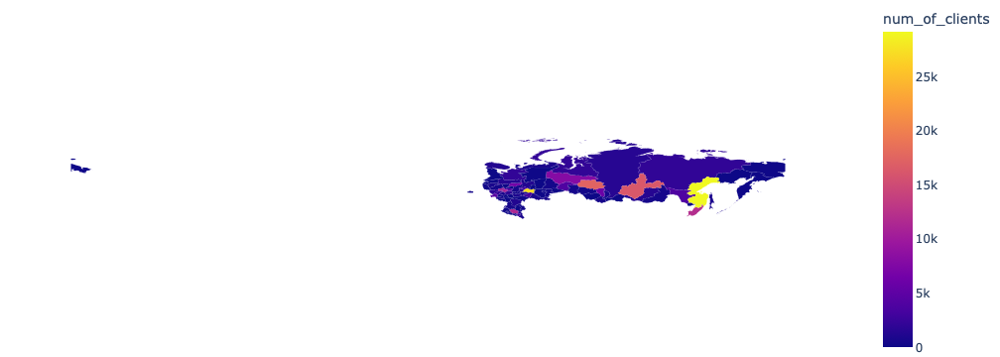

In [78]:
fig = px.choropleth(gdf, geojson=gdf.geometry, locations=gdf.index, color="num_of_clients", hover_data=[gdf.name])
fig.update_geos(fitbounds="locations", visible=False, center = {"lat": 66, "lon": 94})
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=4, mapbox_center = {"lat": 66, "lon": 94})
fig.update_traces(marker_line_width=0)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()